### PGBM-001

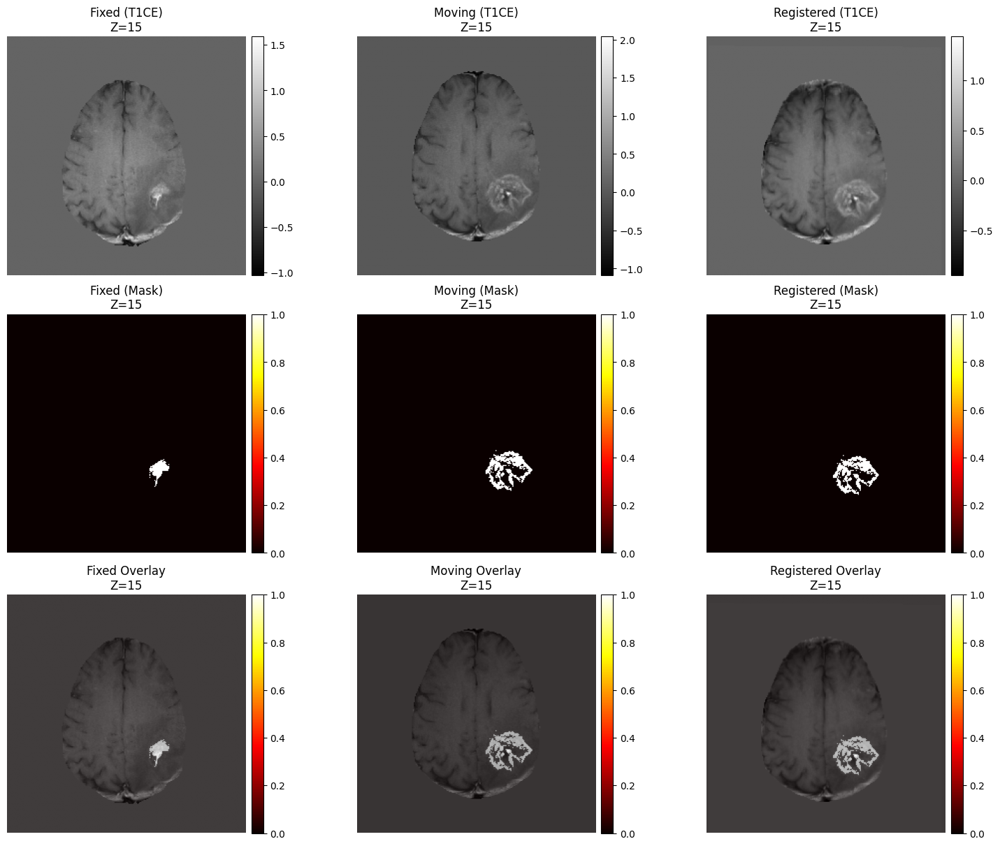

In [5]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

def show_registration_with_overlay(preproc_root, reg_root, case_id,
                                   fixed_date, moving_date,
                                   slice_z=15,
                                   img_mod="t1ce_brain.nii.gz",
                                   reg_img="t1ce2fixed_affine.nii.gz",
                                   mask_name="mask.nii.gz",
                                   reg_mask="mask2fixed_affine.nii.gz"):
    """
    Displays 3x3 grid:
    Row 1: T1CE Fixed, Moving, Registered images
    Row 2: Mask Fixed, Moving, Registered masks
    Row 3: Overlay of image+mask for Fixed, Moving, Registered
    """
    # Paths
    fixed_img_path   = os.path.join(reg_root, case_id, fixed_date,  img_mod)
    moving_img_path  = os.path.join(reg_root, case_id, moving_date, img_mod)
    reg_img_path     = os.path.join(reg_root, case_id, moving_date, reg_img)
    fixed_mask_path  = os.path.join(preproc_root, case_id, fixed_date,  mask_name)
    moving_mask_path = os.path.join(preproc_root, case_id, moving_date, mask_name)
    reg_mask_path    = os.path.join(reg_root, case_id, moving_date, reg_mask)

    # Load volumes
    fixed_img   = nib.load(fixed_img_path).get_fdata()
    moving_img  = nib.load(moving_img_path).get_fdata()
    reg_img_vol = nib.load(reg_img_path).get_fdata()
    fixed_mask  = nib.load(fixed_mask_path).get_fdata()
    moving_mask = nib.load(moving_mask_path).get_fdata()
    reg_mask_vol= nib.load(reg_mask_path).get_fdata()

    # Select slice
    Z, Y, X = fixed_img.shape
    z0 = slice_z if slice_z is not None else Z // 2

    img_slices  = [fixed_img[z0,:,:], moving_img[z0,:,:], reg_img_vol[z0,:,:]]
    mask_slices = [fixed_mask[z0,:,:], moving_mask[z0,:,:], reg_mask_vol[z0,:,:]]

    # Plot 3x3
    fig, axes = plt.subplots(3, 3, figsize=(15, 12), constrained_layout=True)
    titles = ["Fixed", "Moving", "Registered"]

    # Row 1: images
    for i, ax in enumerate(axes[0]):
        im = ax.imshow(img_slices[i], cmap="gray", aspect="equal")
        ax.set_title(f"{titles[i]} (T1CE)\nZ={z0}")
        ax.axis("off")
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

    # Row 2: masks
    for i, ax in enumerate(axes[1]):
        im = ax.imshow(mask_slices[i], cmap="hot", aspect="equal")
        ax.set_title(f"{titles[i]} (Mask)\nZ={z0}")
        ax.axis("off")
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

    # Row 3: overlay
    for i, ax in enumerate(axes[2]):
        ax.imshow(img_slices[i], cmap="gray", aspect="equal")
        ax.imshow(mask_slices[i], cmap="hot", alpha=0.4, aspect="equal")
        ax.set_title(f"{titles[i]} Overlay\nZ={z0}")
        ax.axis("off")
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

    plt.show()


# ───────── 사용 예 ─────────
preproc_root = "/mnt/ssd/brain-tumor-prediction/data/btp_preproc_fixed22"
reg_root     = "/mnt/ssd/brain-tumor-prediction/data/btp_reg_flirt_t1ce_fixed22"
case_id      = "PGBM-001"
fixed_date   = "1991-11-19"
moving_date  = "1992-04-02"

show_registration_with_overlay(preproc_root, reg_root, case_id,
                               fixed_date, moving_date,
                               slice_z=15)


### PGBM-001 (전체 슬라이스)

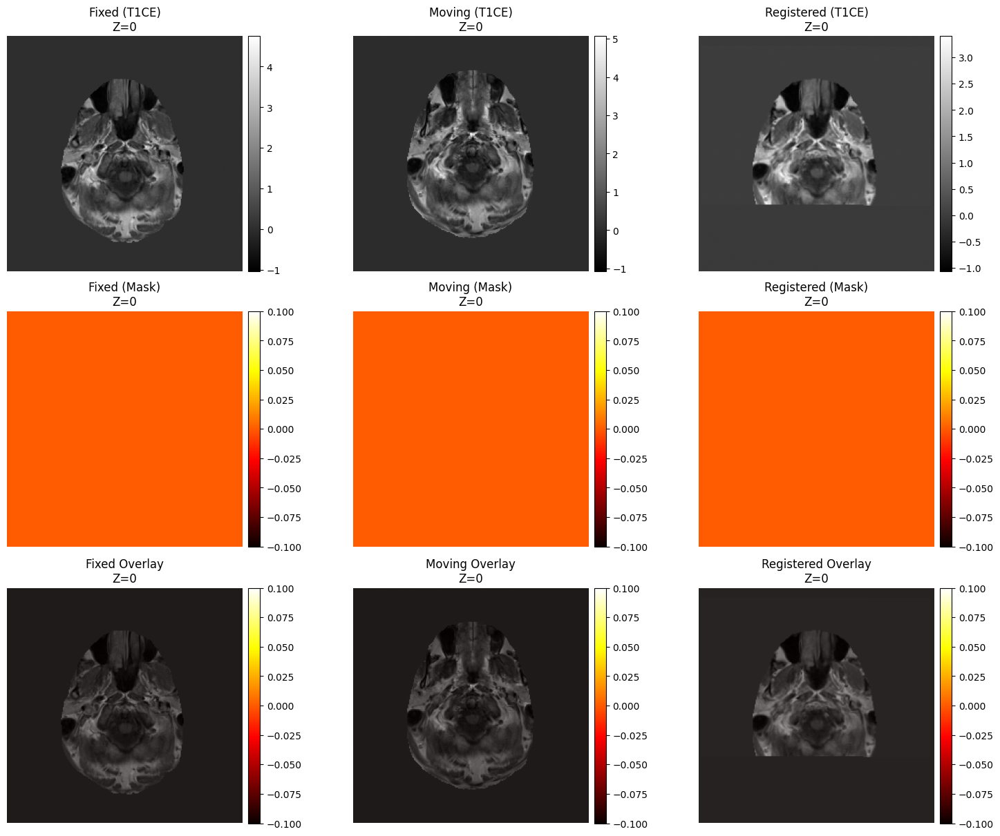

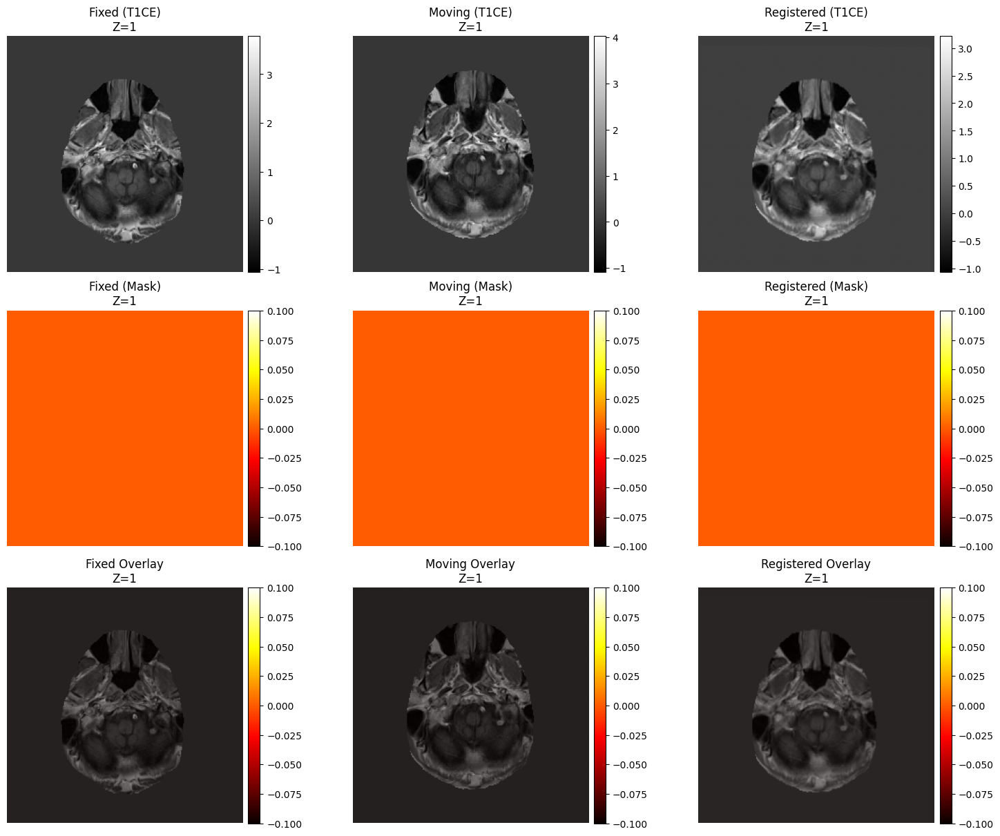

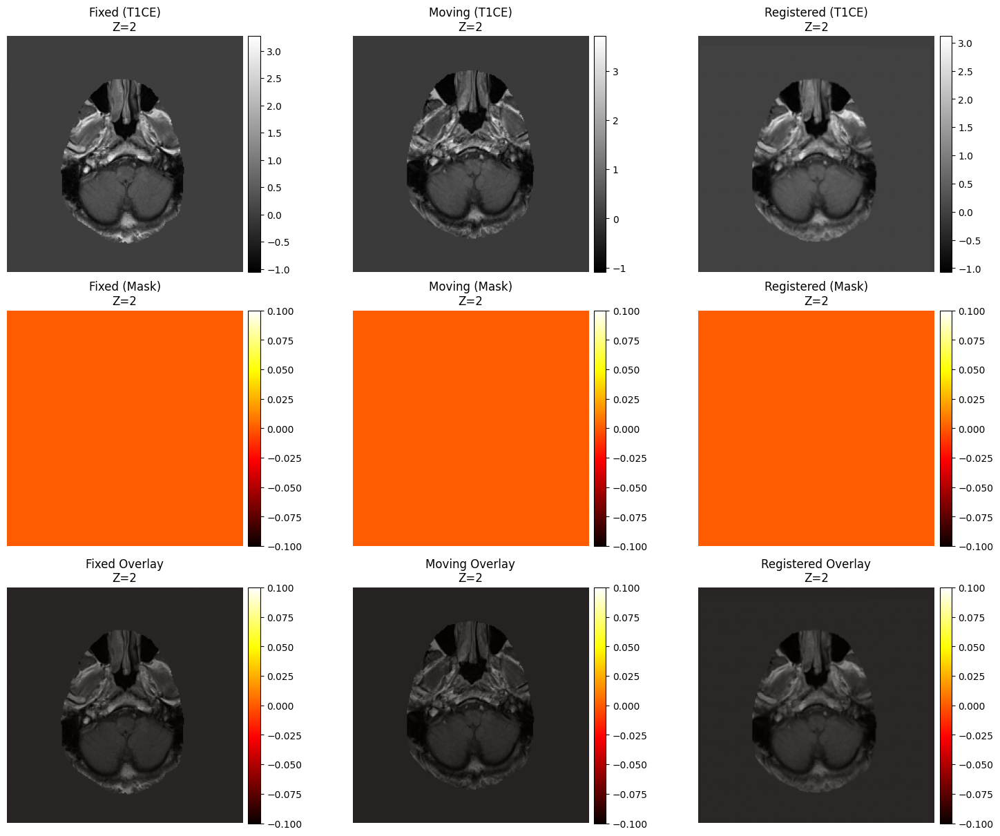

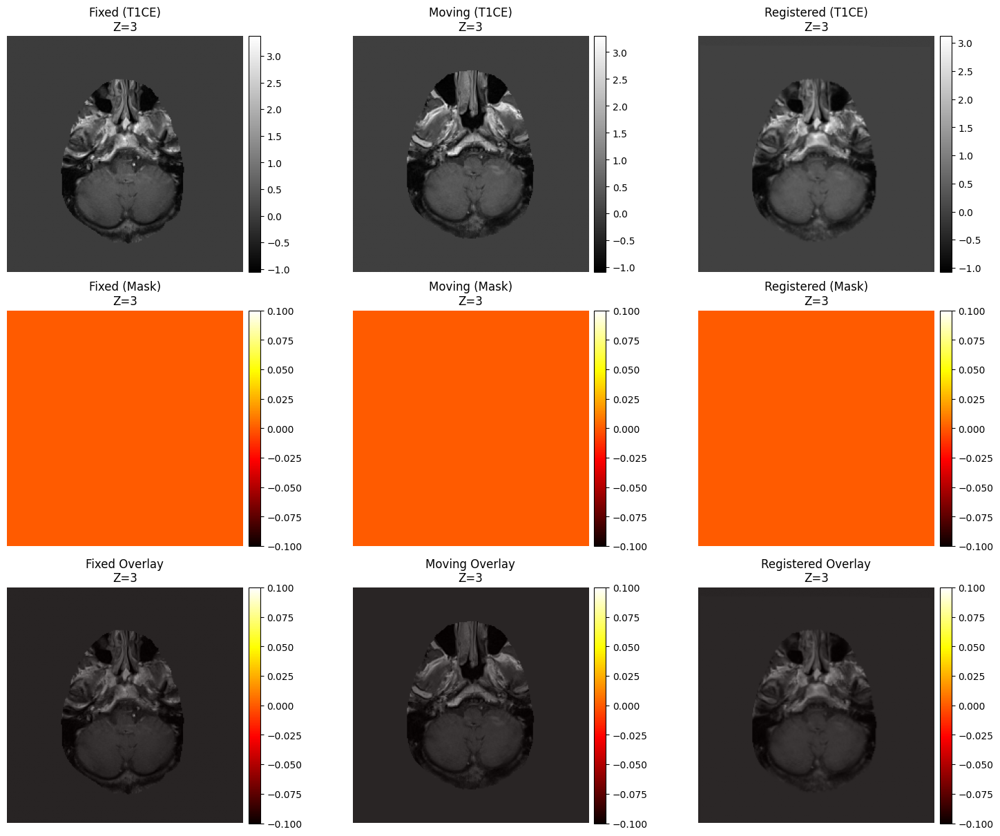

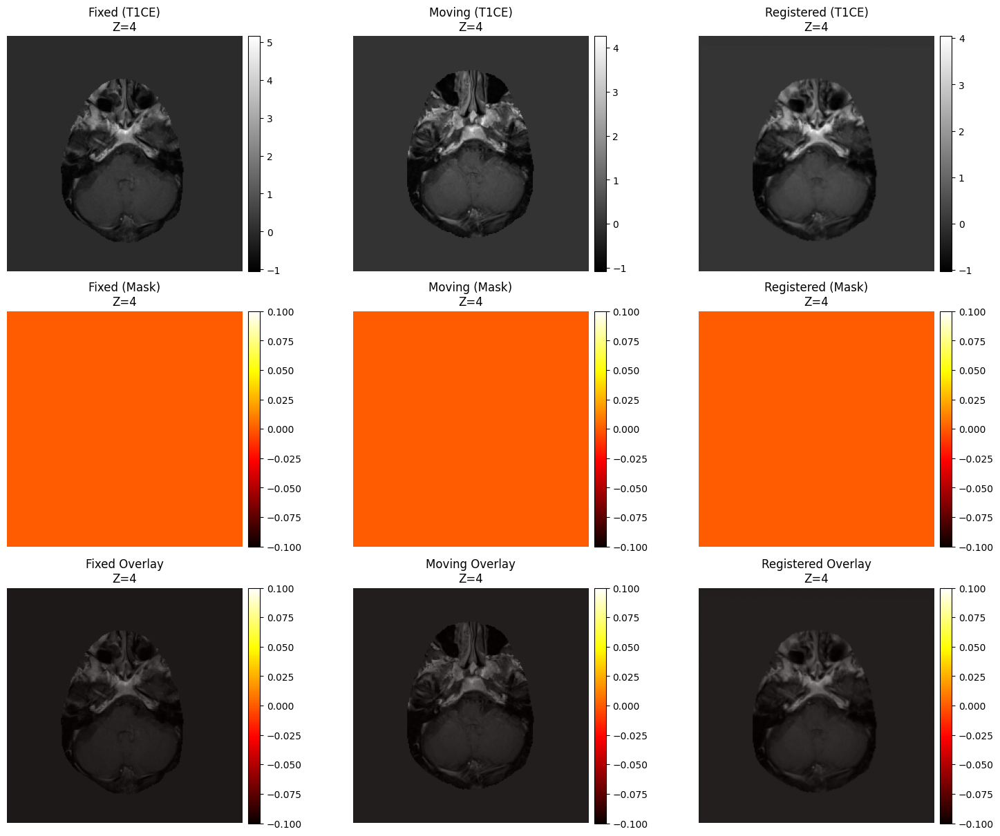

...

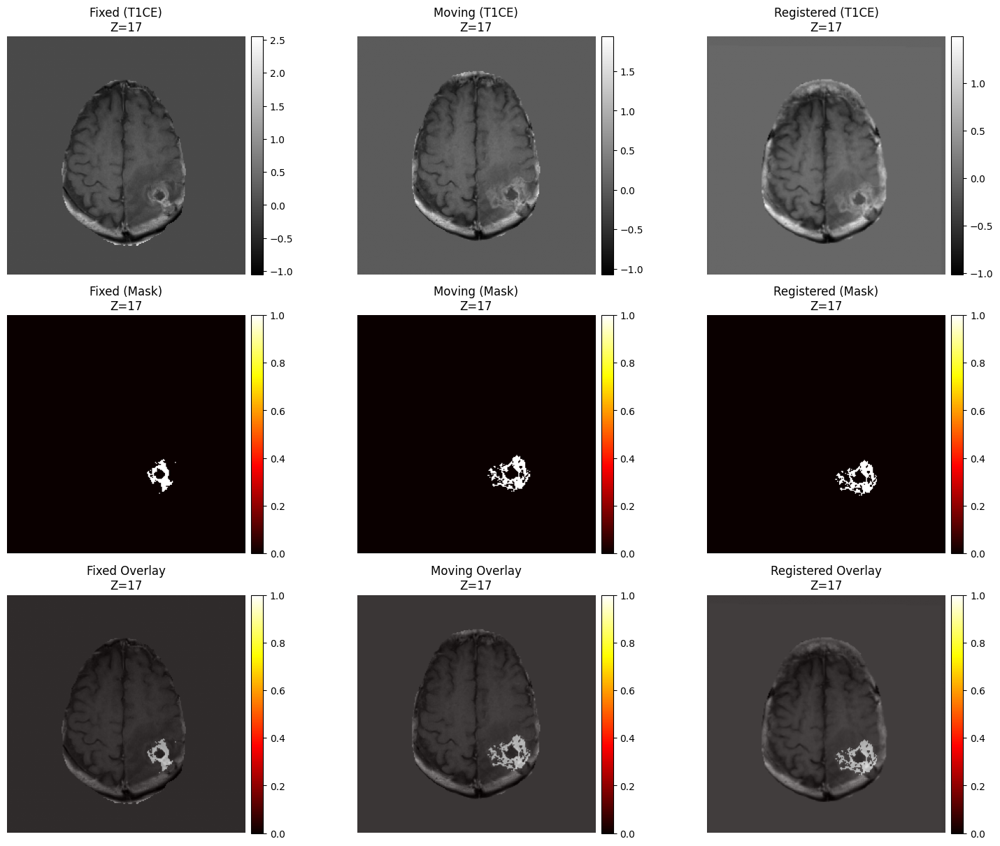

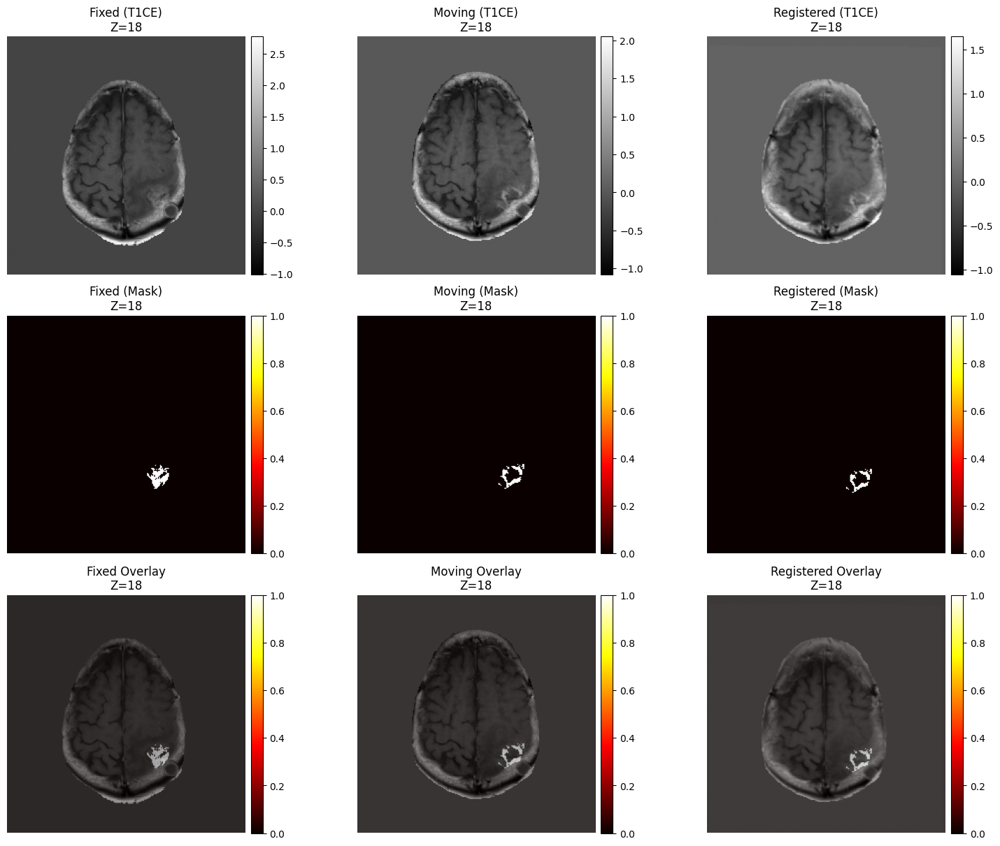

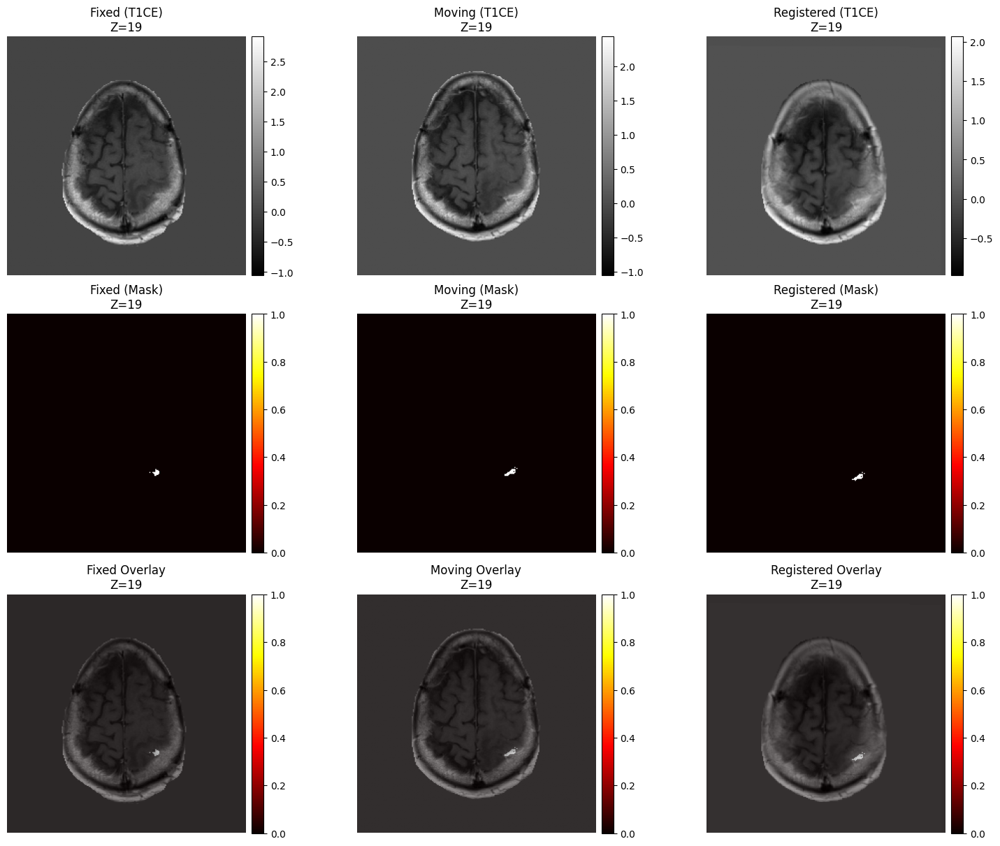

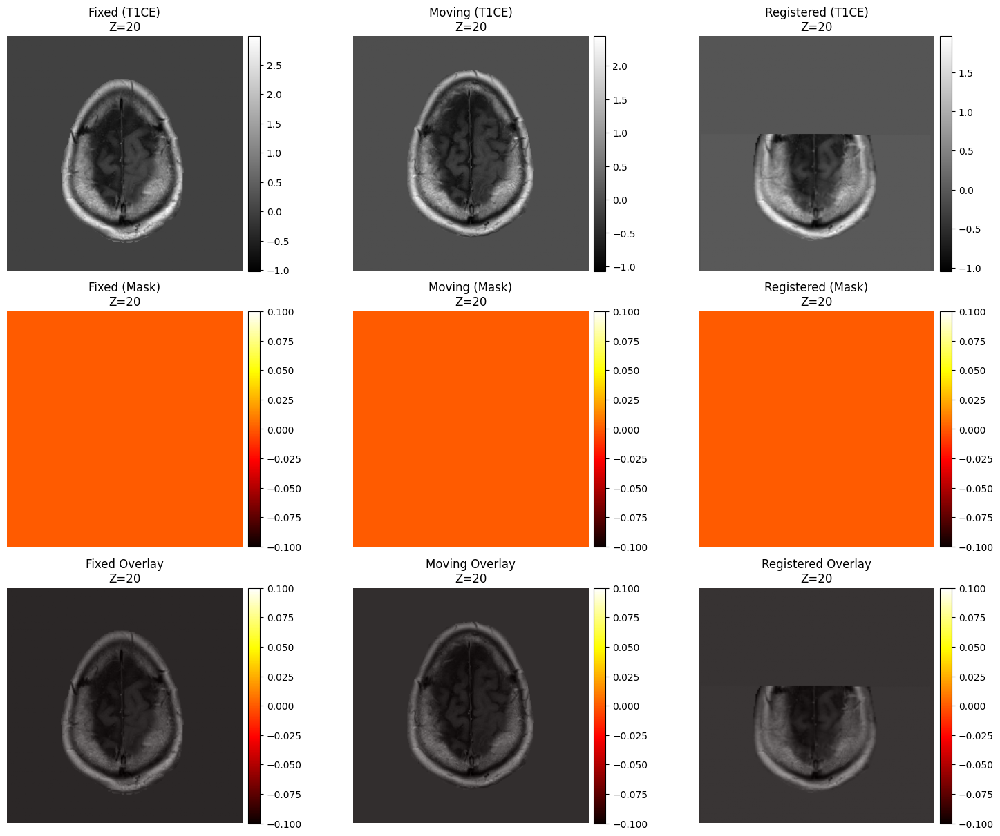

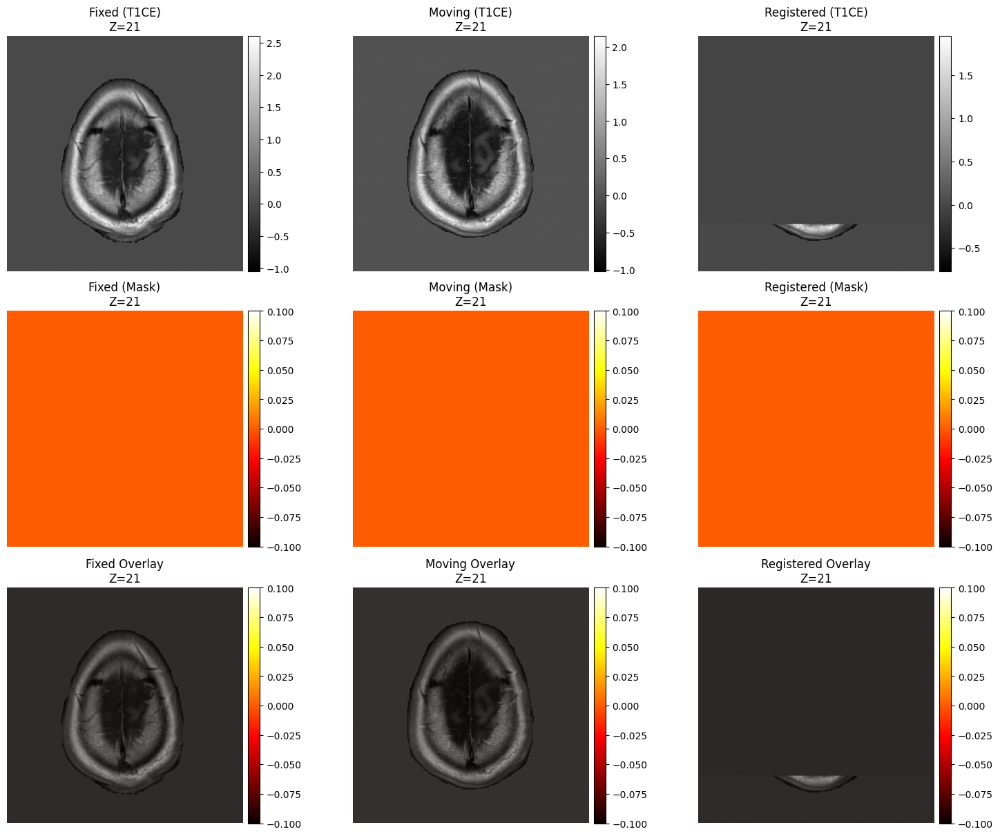

In [8]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

def show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                       fixed_date, moving_date,
                                       img_mod="t1ce_brain.nii.gz",
                                       reg_img="t1ce2fixed_affine.nii.gz",
                                       mask_name="mask.nii.gz",
                                       reg_mask="mask2fixed_affine.nii.gz",
                                       pause=0.5):
    """
    Iterate through all Z-slices, displaying a 3x3 grid for each:
      Row 1: Fixed / Moving / Registered images
      Row 2: Fixed / Moving / Registered masks
      Row 3: Overlays (mask in red) for Fixed / Moving / Registered
    """
    # Load volumes once
    fixed_img   = nib.load(os.path.join(reg_root, case_id, fixed_date,  img_mod)).get_fdata()
    moving_img  = nib.load(os.path.join(reg_root, case_id, moving_date, img_mod)).get_fdata()
    reg_img_vol = nib.load(os.path.join(reg_root, case_id, moving_date, reg_img)).get_fdata()
    fixed_mask  = nib.load(os.path.join(preproc_root, case_id, fixed_date,  mask_name)).get_fdata()
    moving_mask = nib.load(os.path.join(preproc_root, case_id, moving_date, mask_name)).get_fdata()
    reg_mask_vol= nib.load(os.path.join(reg_root, case_id, moving_date, reg_mask)).get_fdata()

    Z, Y, X = fixed_img.shape
    titles = ["Fixed", "Moving", "Registered"]

    for z0 in range(Z):
        fig, axes = plt.subplots(3, 3, figsize=(15, 12), constrained_layout=True)
        # Row 1: images
        for i, ax in enumerate(axes[0]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            im = ax.imshow(img, cmap="gray", aspect="equal")
            ax.set_title(f"{titles[i]} (T1CE)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 2: masks
        for i, ax in enumerate(axes[1]):
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            im = ax.imshow(msk, cmap="hot", aspect="equal")
            ax.set_title(f"{titles[i]} (Mask)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 3: overlay
        for i, ax in enumerate(axes[2]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            ax.imshow(img, cmap="gray", aspect="equal")
            ax.imshow(msk, cmap="hot", alpha=0.4, aspect="equal")
            ax.set_title(f"{titles[i]} Overlay\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

        plt.show()
        plt.pause(pause)
        plt.close(fig)

# ───────── 사용 예 ─────────
preproc_root = "/mnt/ssd/brain-tumor-prediction/data/btp_preproc_fixed22"
reg_root     = "/mnt/ssd/brain-tumor-prediction/data/btp_reg_flirt_t1ce_fixed22"
case_id      = "PGBM-001"
fixed_date   = "1991-11-19"
moving_date  = "1992-04-02"

show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                   fixed_date, moving_date,
                                   pause=0.3)


### PGBM-002

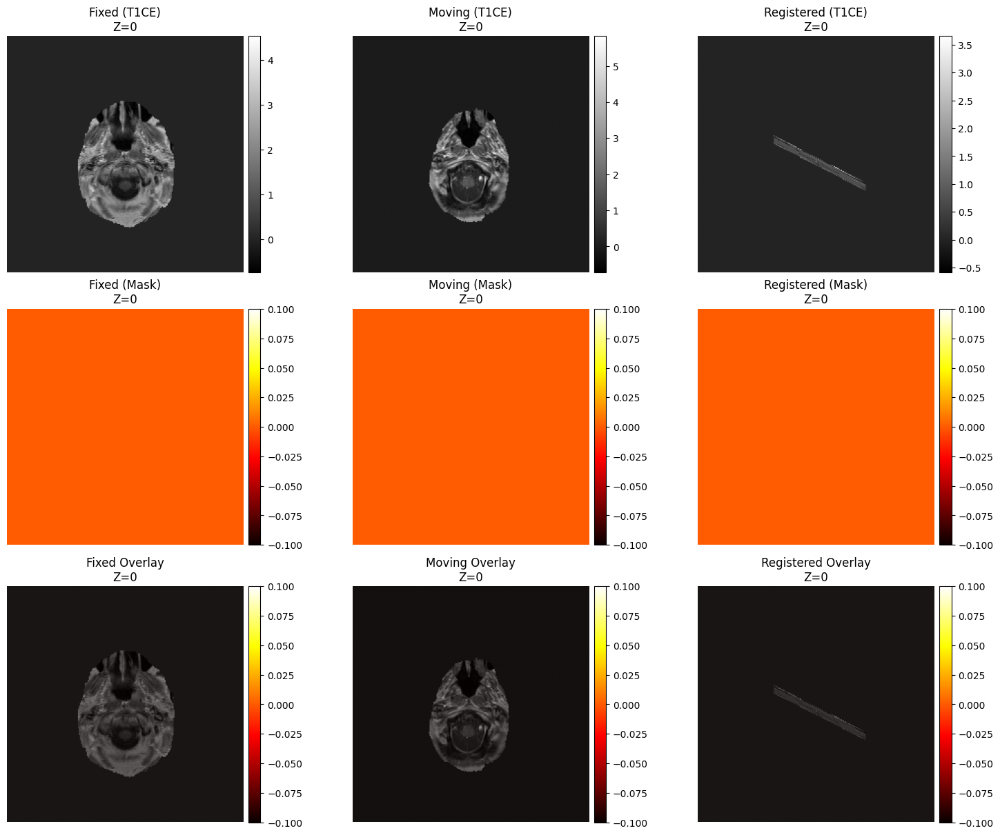

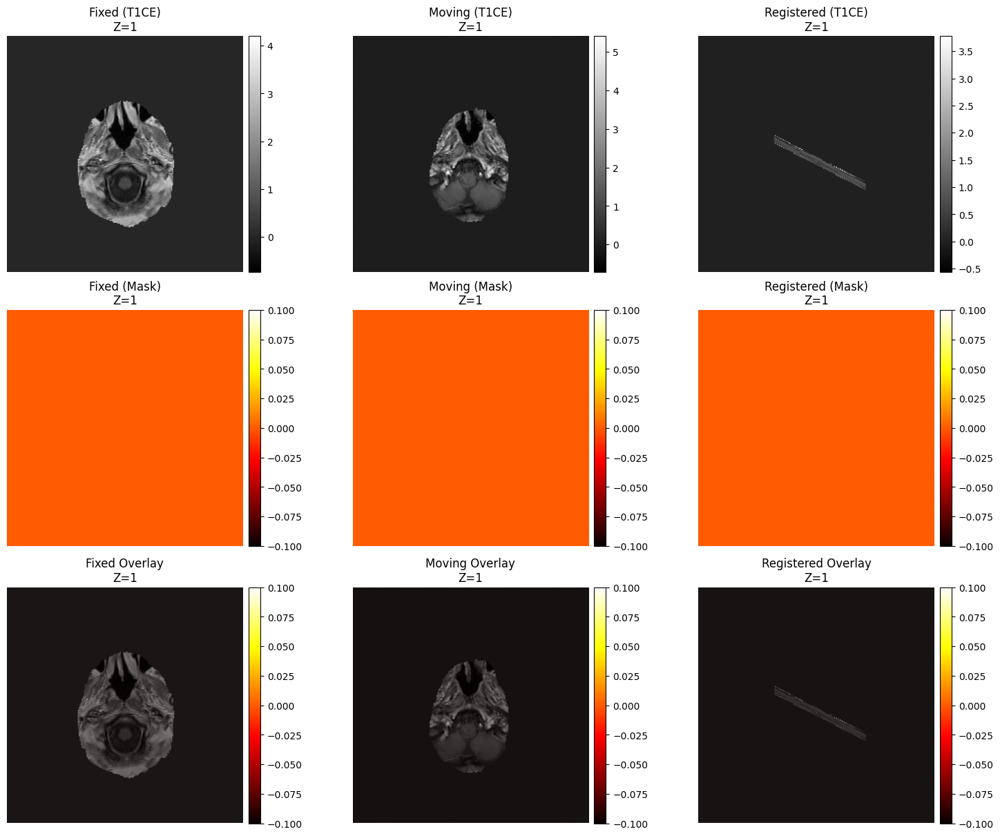

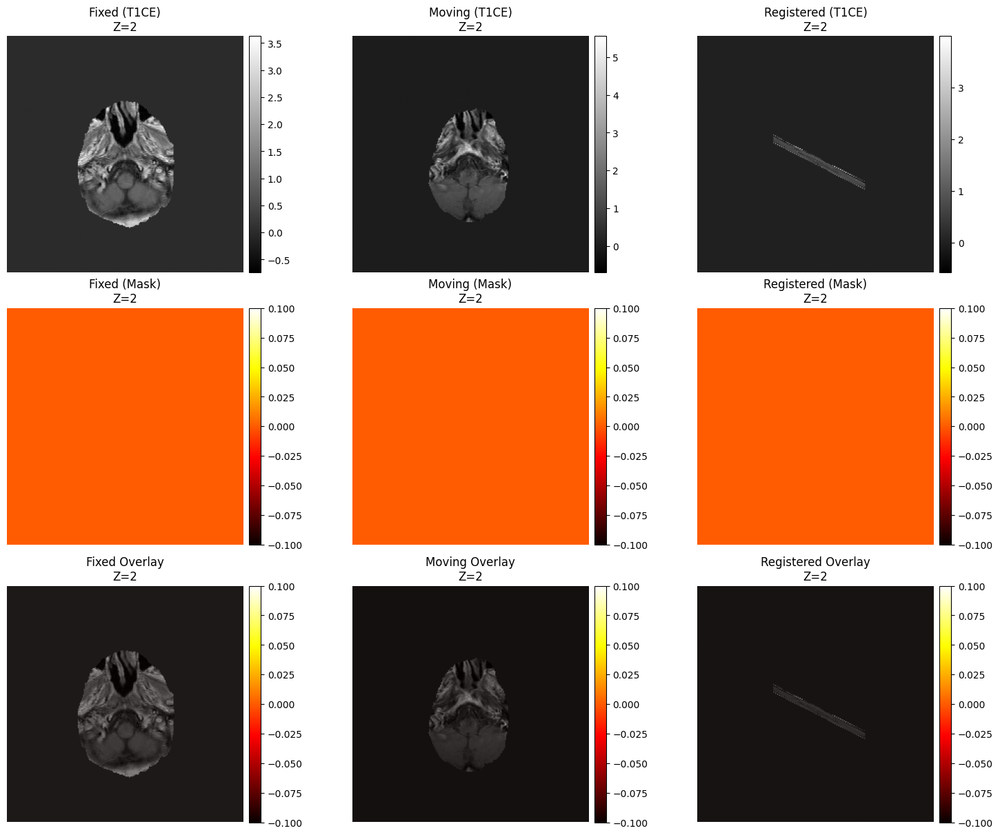

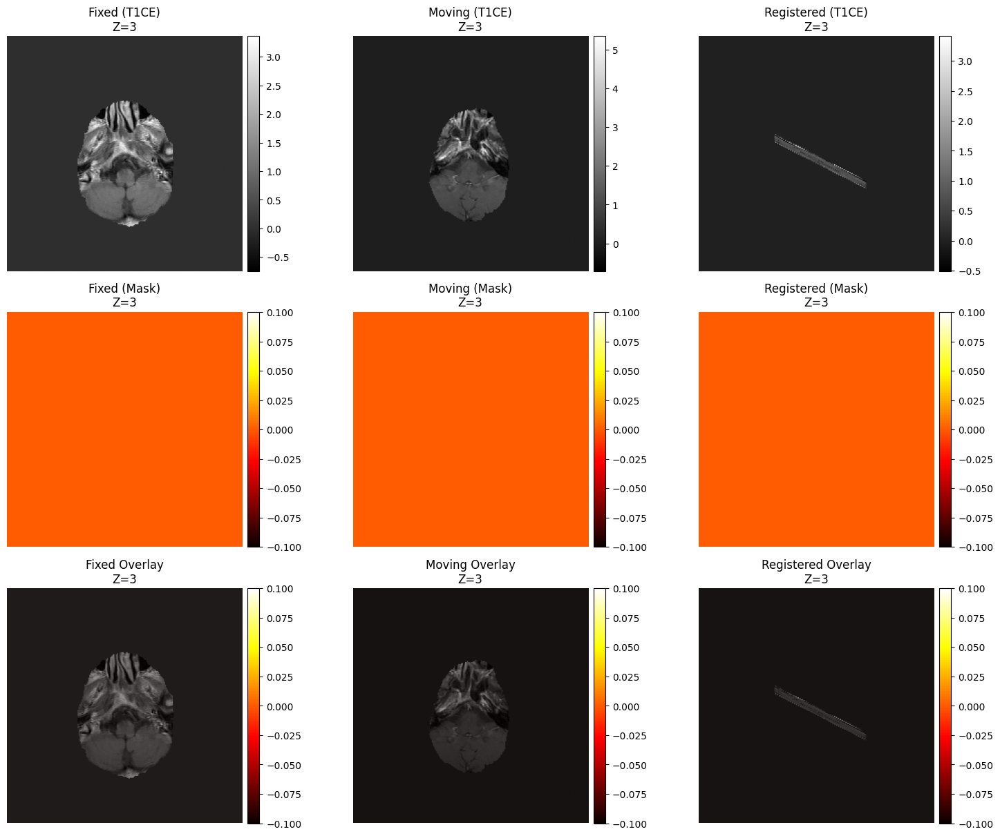

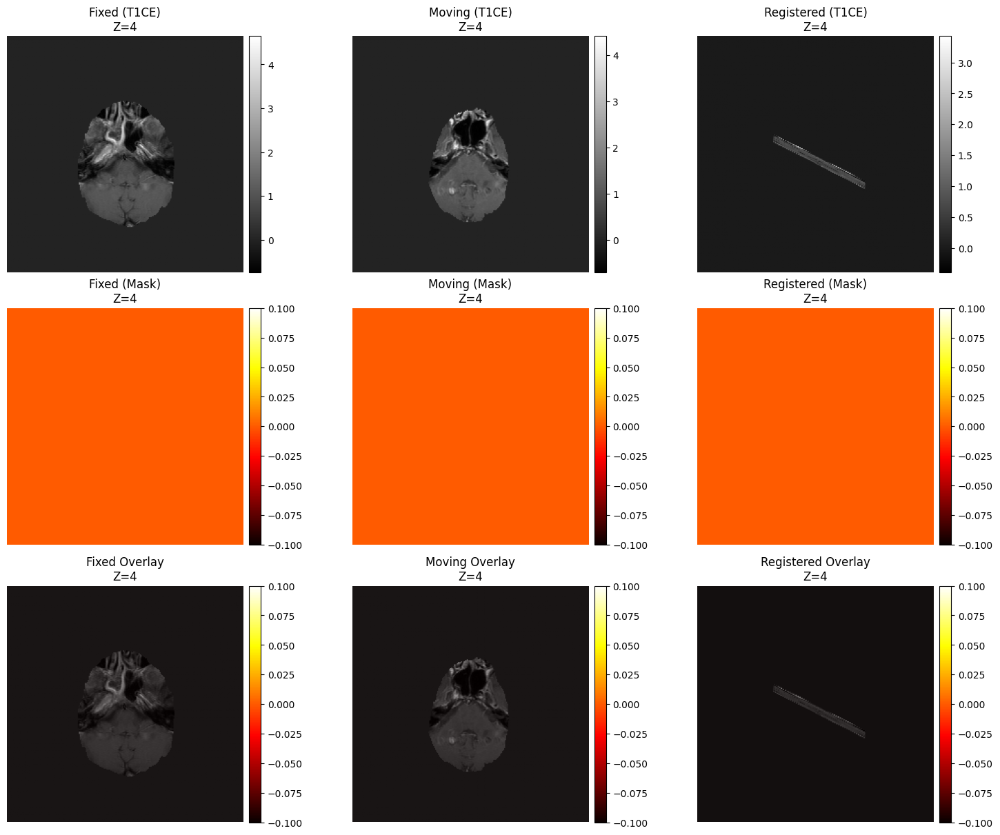

...

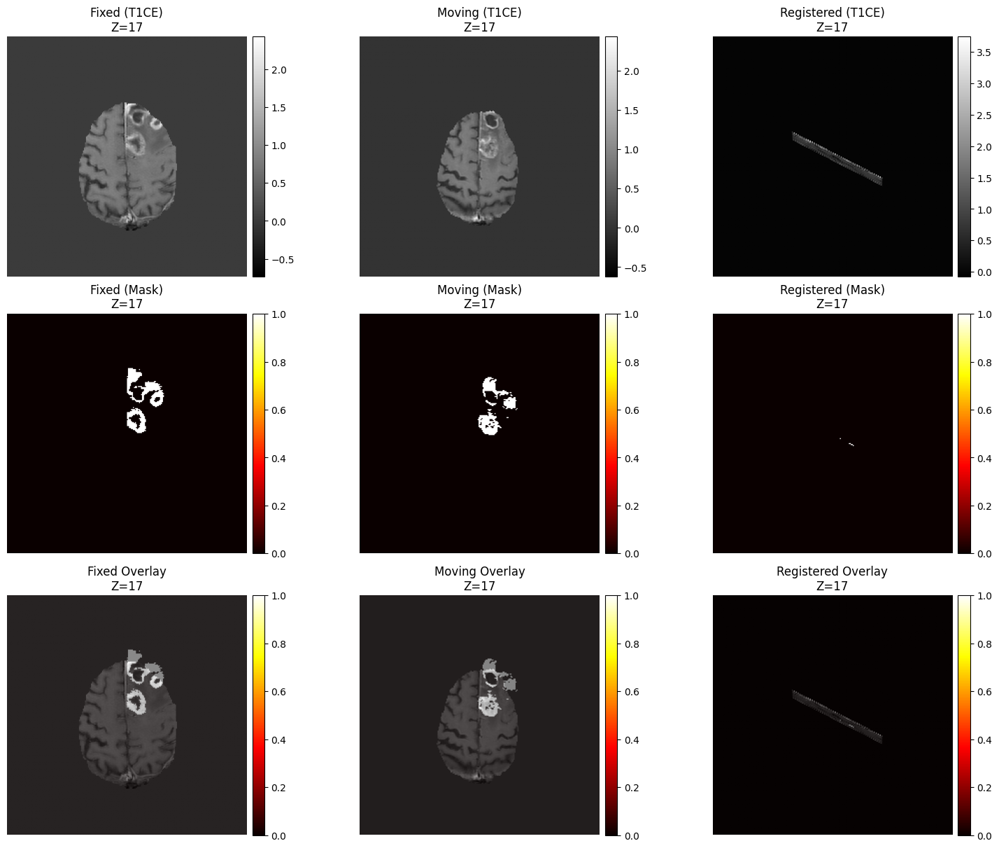

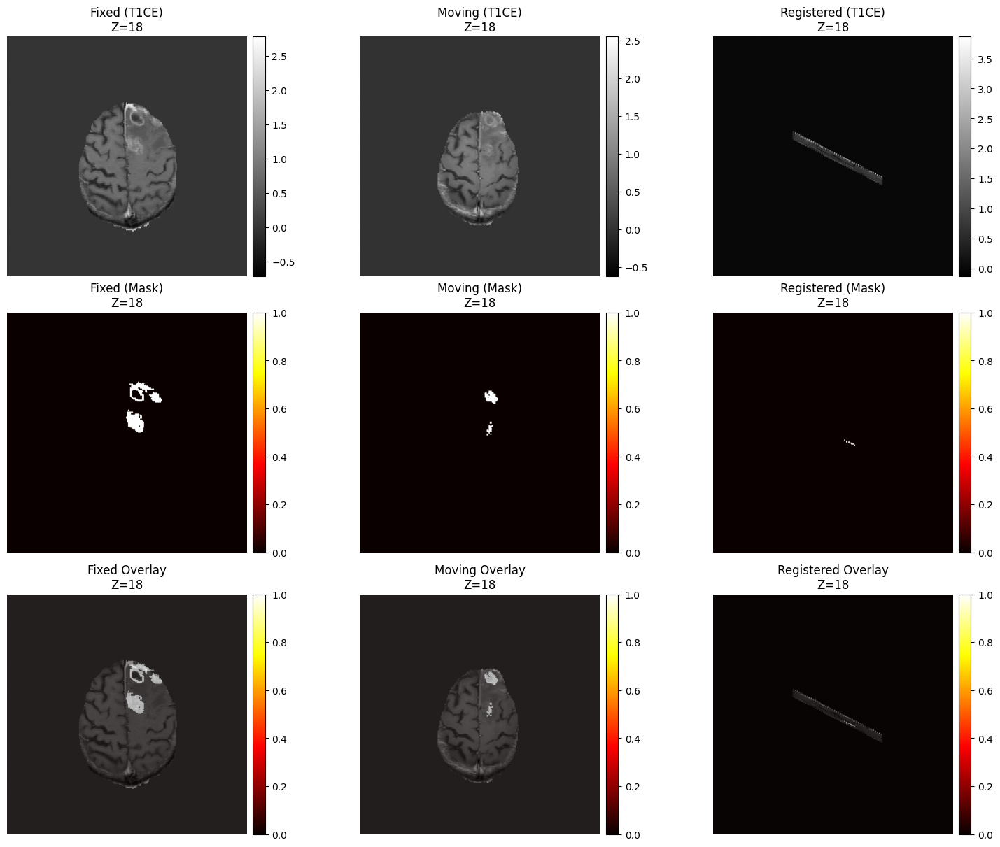

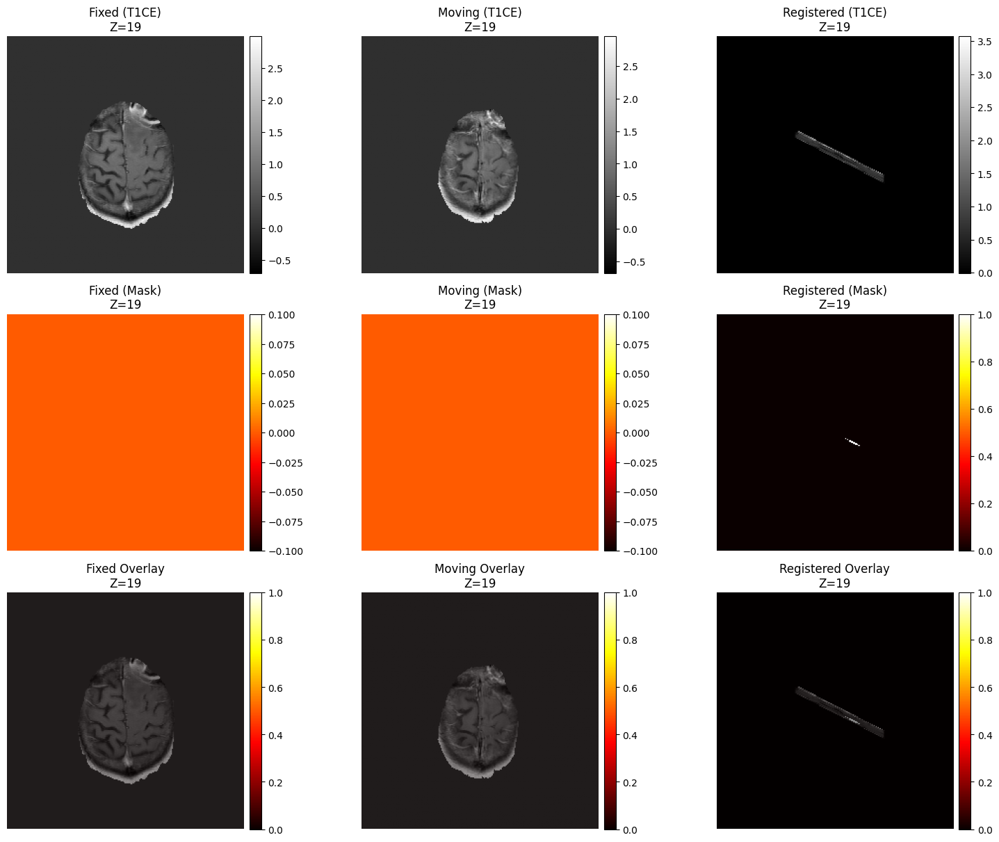

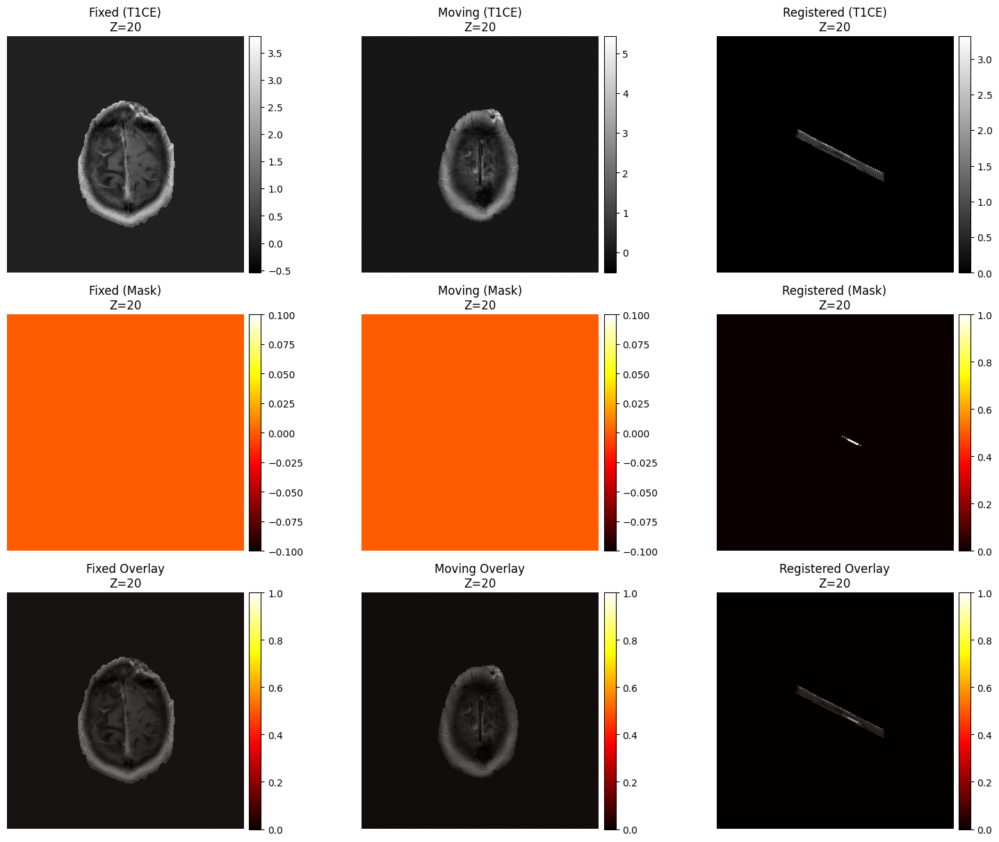

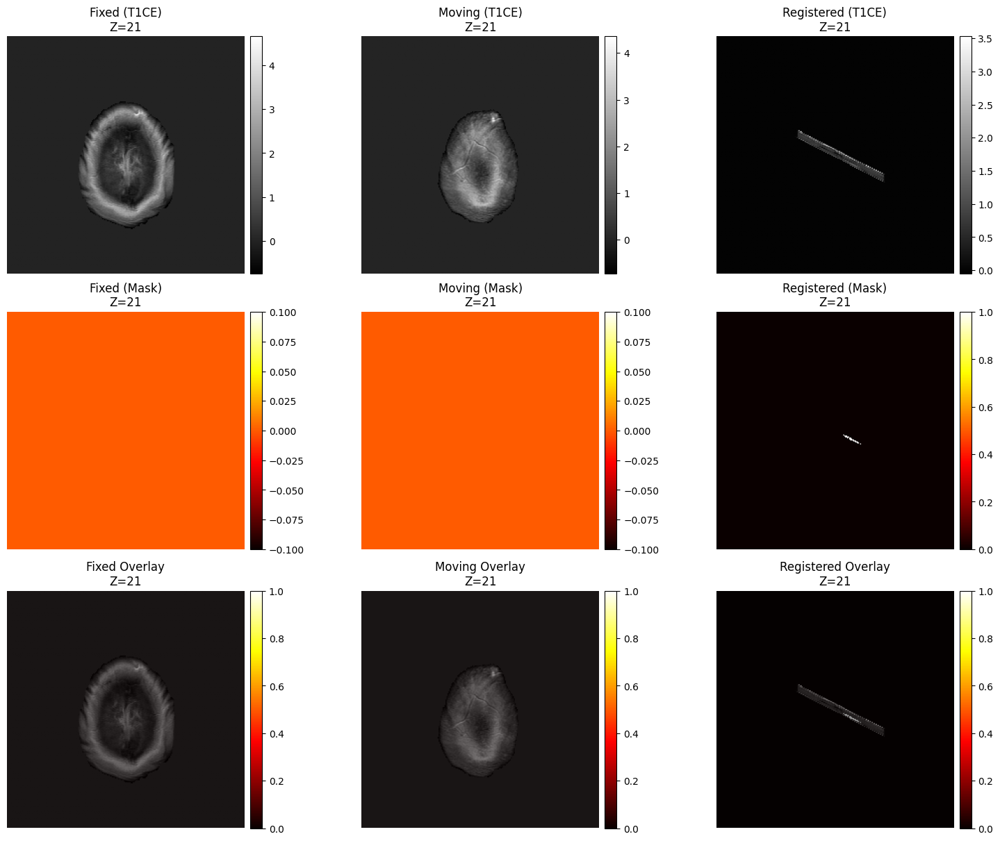

In [11]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

def show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                       fixed_date, moving_date,
                                       img_mod="t1ce_brain.nii.gz",
                                       reg_img="t1ce2fixed_affine.nii.gz",
                                       mask_name="mask.nii.gz",
                                       reg_mask="mask2fixed_affine.nii.gz",
                                       pause=0.5):
    """
    Iterate through all Z-slices, displaying a 3x3 grid for each:
      Row 1: Fixed / Moving / Registered images
      Row 2: Fixed / Moving / Registered masks
      Row 3: Overlays (mask in red) for Fixed / Moving / Registered
    """
    # Load volumes once
    fixed_img   = nib.load(os.path.join(reg_root, case_id, fixed_date,  img_mod)).get_fdata()
    moving_img  = nib.load(os.path.join(reg_root, case_id, moving_date, img_mod)).get_fdata()
    reg_img_vol = nib.load(os.path.join(reg_root, case_id, moving_date, reg_img)).get_fdata()
    fixed_mask  = nib.load(os.path.join(preproc_root, case_id, fixed_date,  mask_name)).get_fdata()
    moving_mask = nib.load(os.path.join(preproc_root, case_id, moving_date, mask_name)).get_fdata()
    reg_mask_vol= nib.load(os.path.join(reg_root, case_id, moving_date, reg_mask)).get_fdata()

    Z, Y, X = fixed_img.shape
    titles = ["Fixed", "Moving", "Registered"]

    for z0 in range(Z):
        fig, axes = plt.subplots(3, 3, figsize=(15, 12), constrained_layout=True)
        # Row 1: images
        for i, ax in enumerate(axes[0]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            im = ax.imshow(img, cmap="gray", aspect="equal")
            ax.set_title(f"{titles[i]} (T1CE)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 2: masks
        for i, ax in enumerate(axes[1]):
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            im = ax.imshow(msk, cmap="hot", aspect="equal")
            ax.set_title(f"{titles[i]} (Mask)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 3: overlay
        for i, ax in enumerate(axes[2]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            ax.imshow(img, cmap="gray", aspect="equal")
            ax.imshow(msk, cmap="hot", alpha=0.4, aspect="equal")
            ax.set_title(f"{titles[i]} Overlay\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

        plt.show()
        plt.pause(pause)
        plt.close(fig)

# ───────── 사용 예 ─────────
preproc_root = "/mnt/ssd/brain-tumor-prediction/data/btp_preproc_fixed22"
reg_root     = "/mnt/ssd/brain-tumor-prediction/data/btp_reg_flirt_t1ce_fixed22"
case_id      = "PGBM-002"
fixed_date   = "1996-08-13"
moving_date  = "1997-01-17"

show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                   fixed_date, moving_date,
                                   pause=0.3)


### PGBM-003

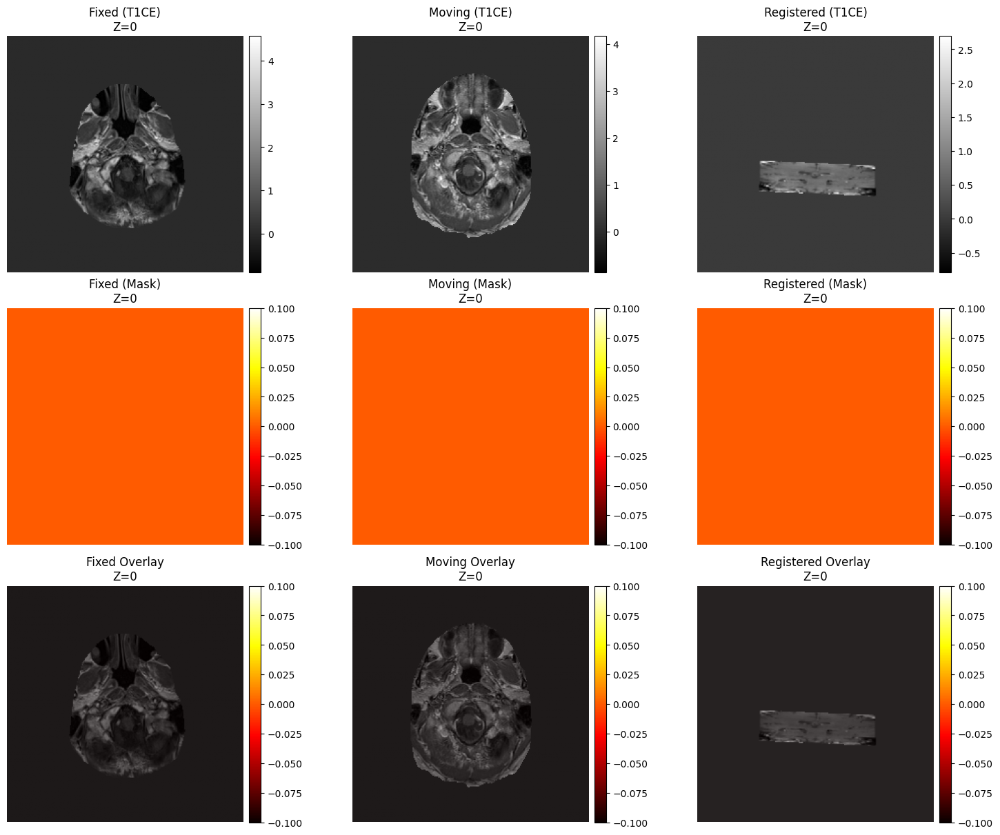

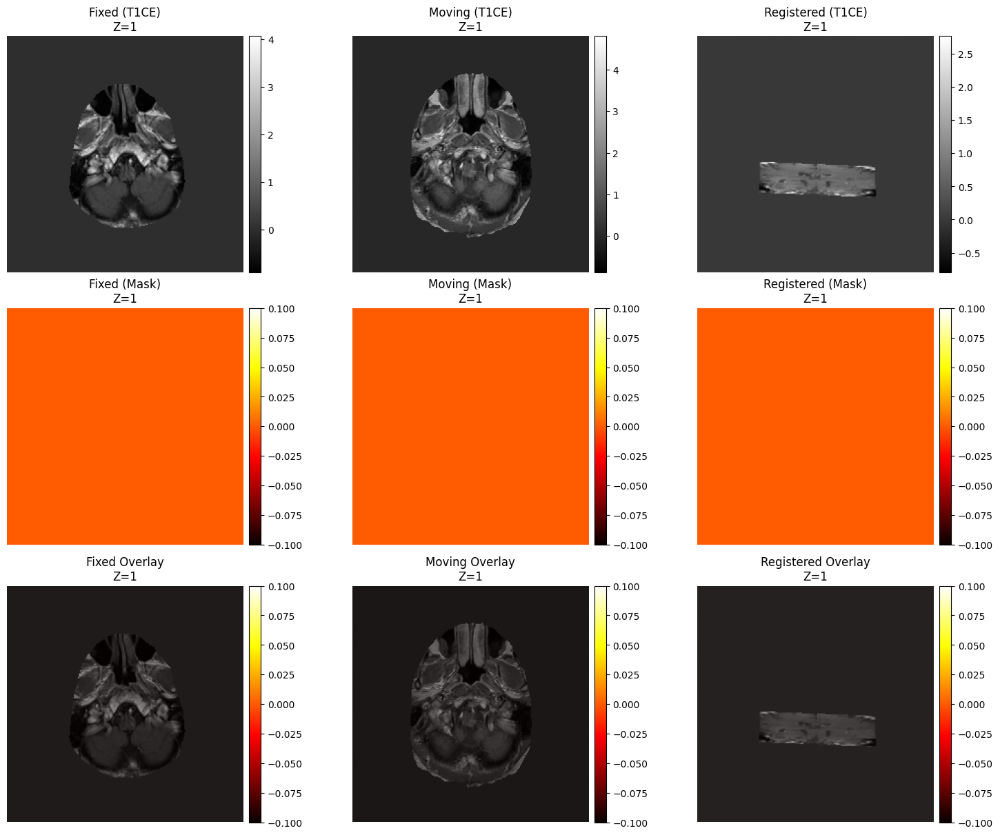

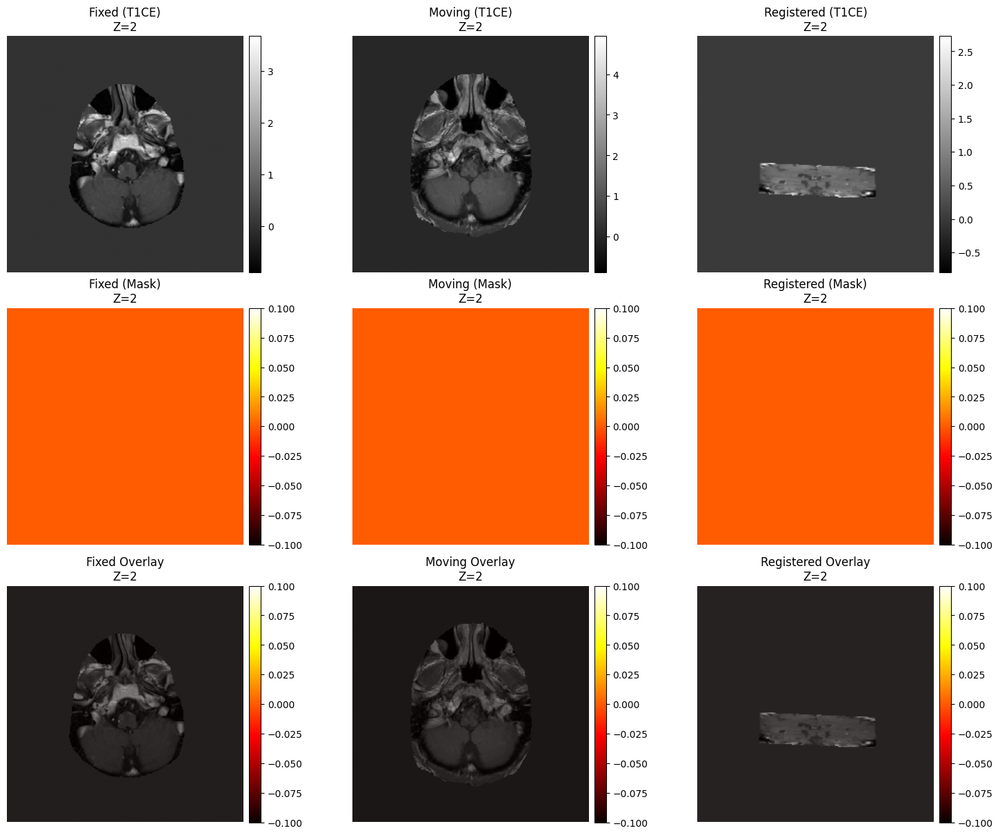

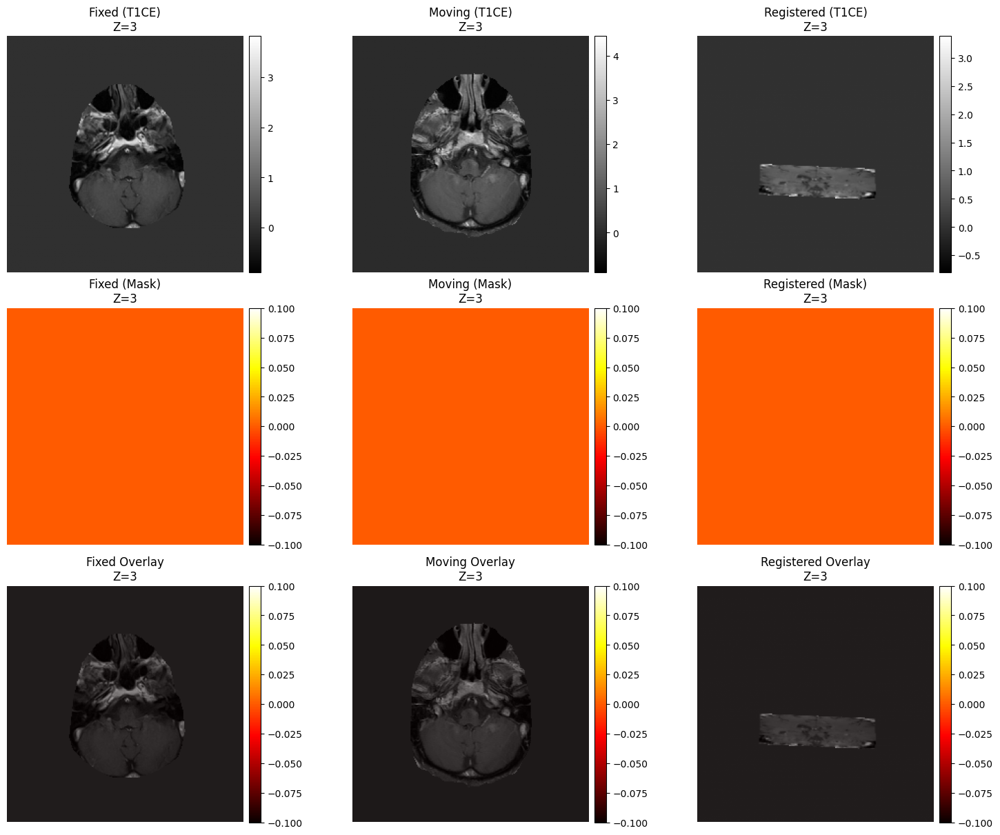

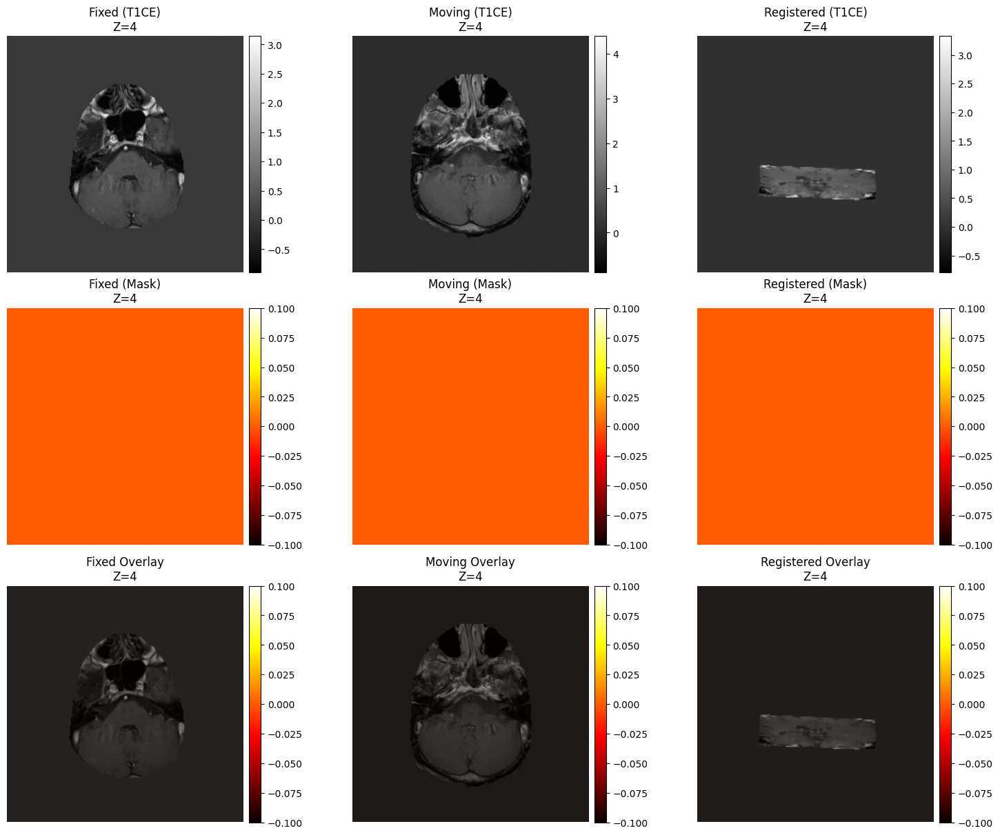

...

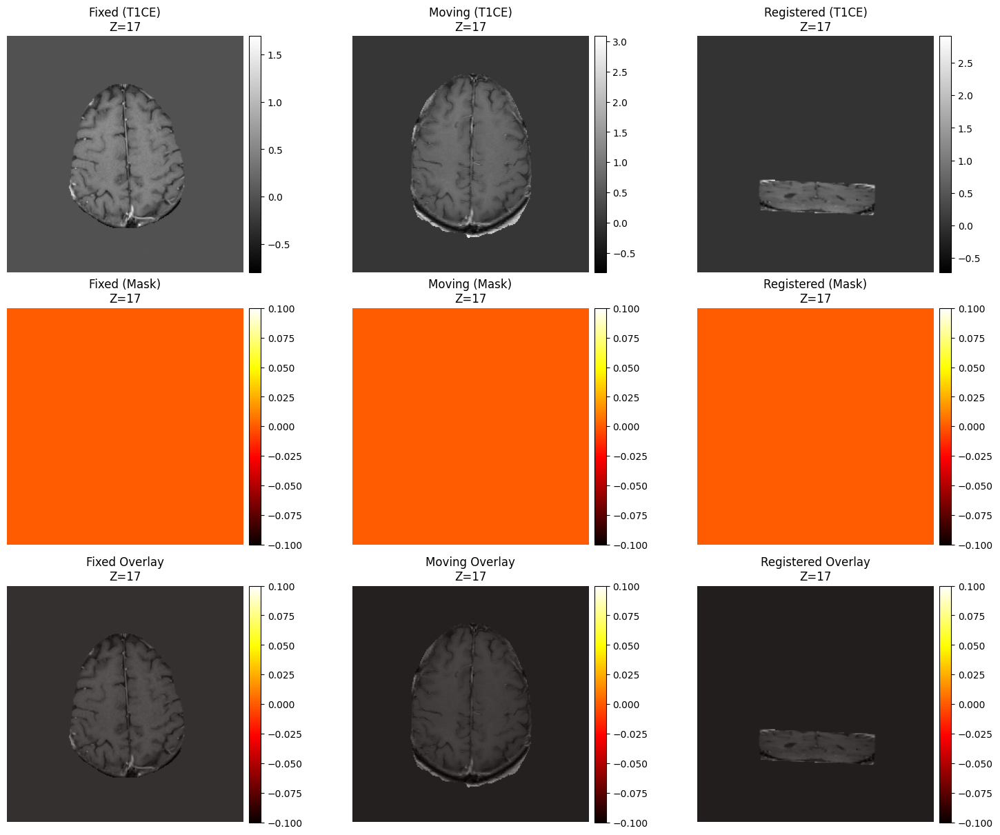

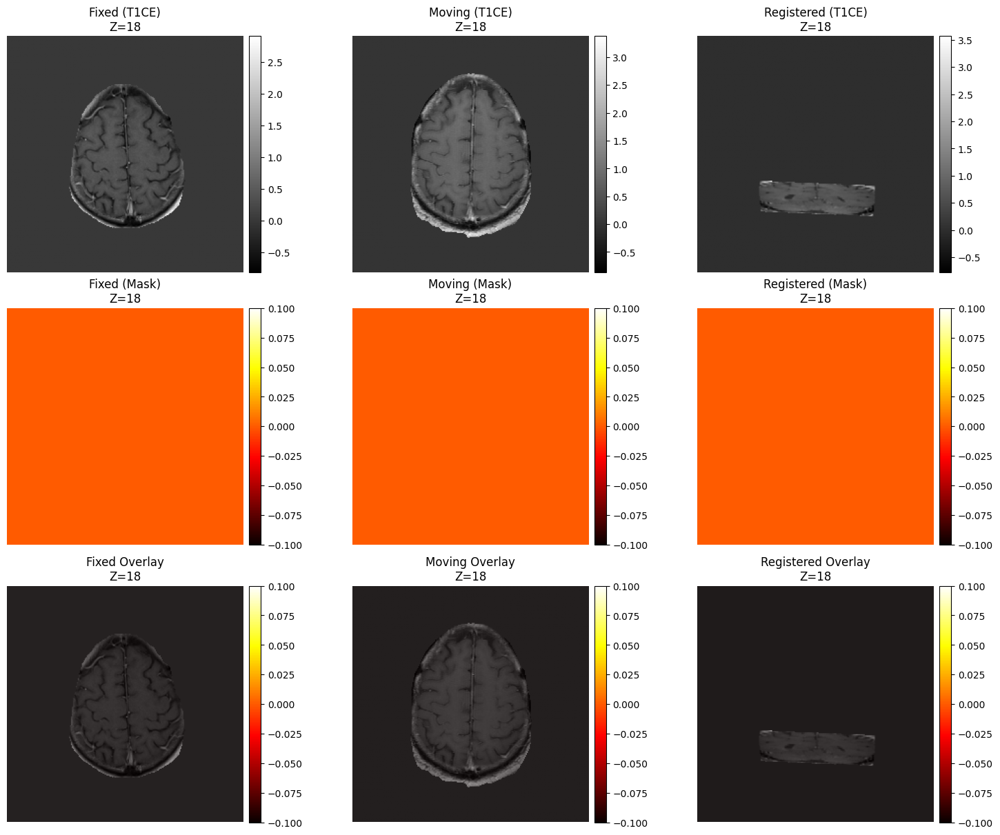

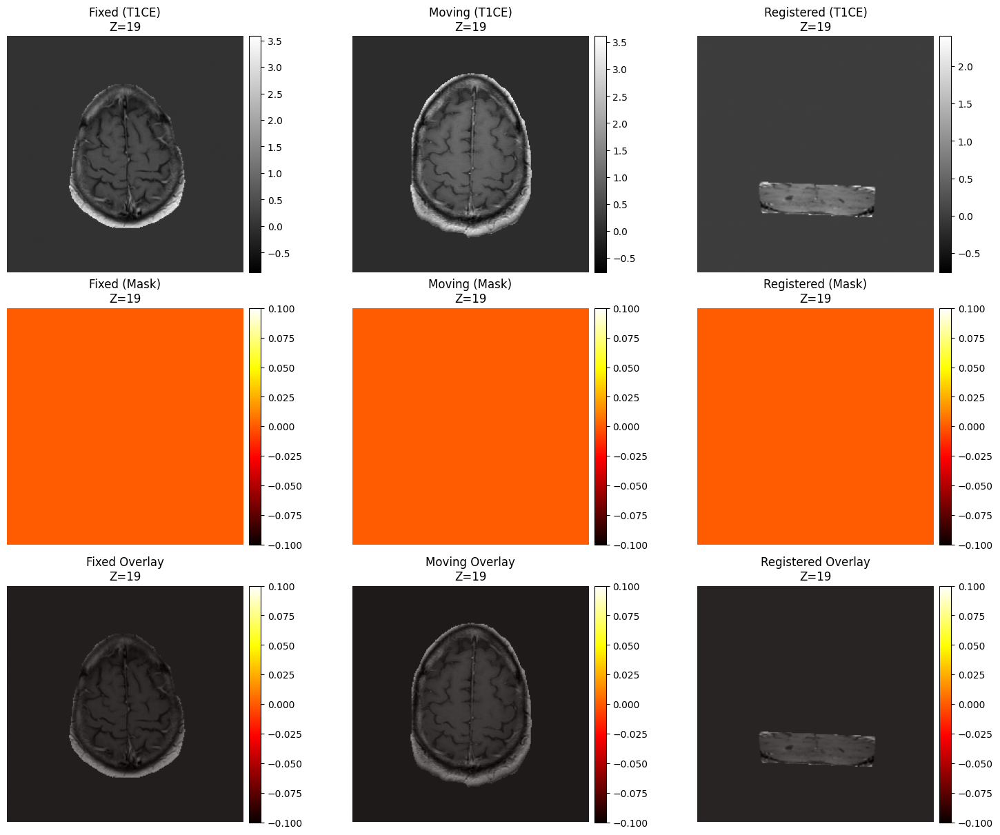

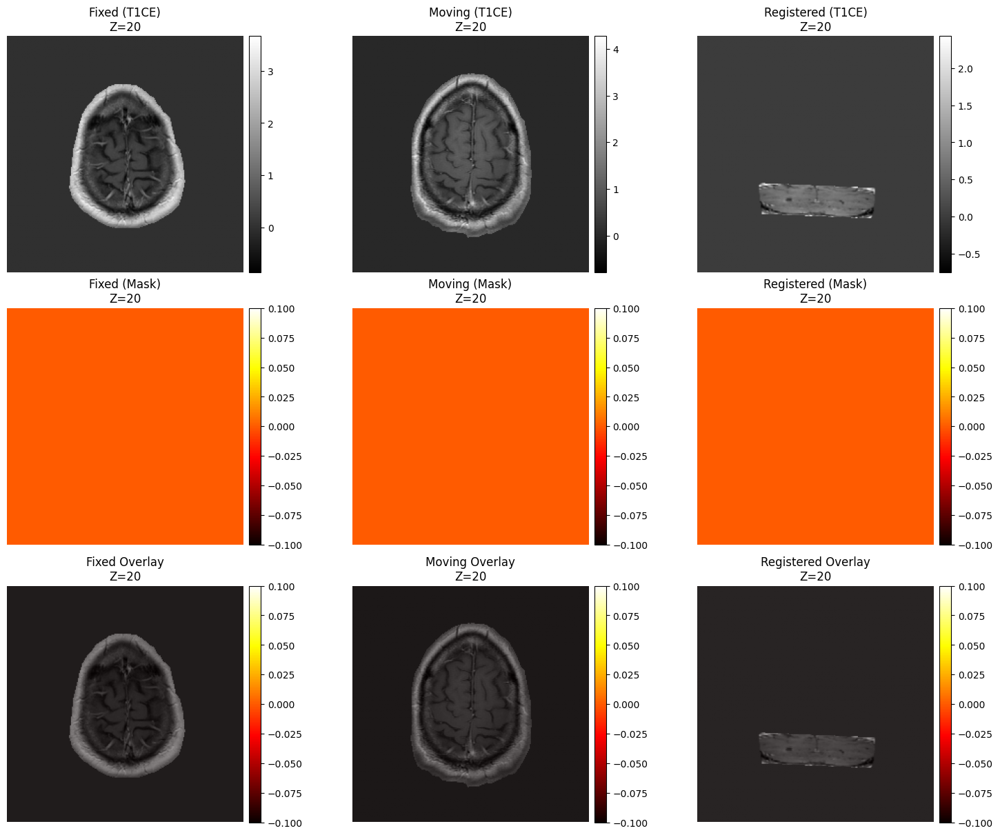

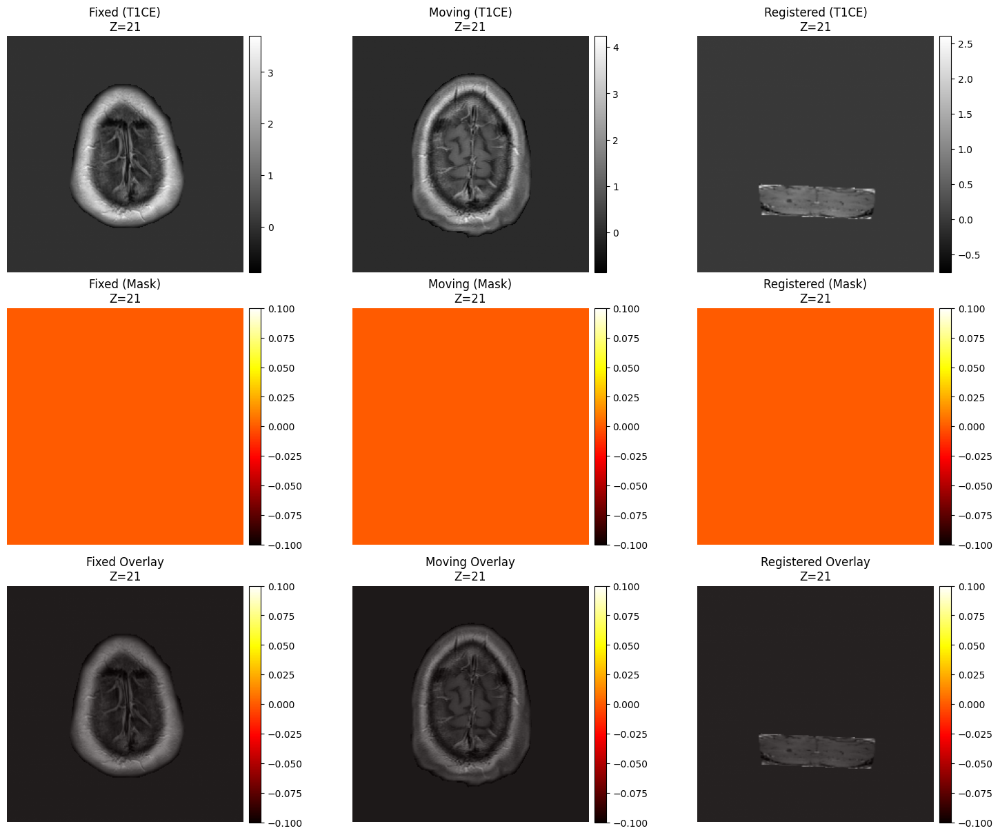

In [10]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

def show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                       fixed_date, moving_date,
                                       img_mod="t1ce_brain.nii.gz",
                                       reg_img="t1ce2fixed_affine.nii.gz",
                                       mask_name="mask.nii.gz",
                                       reg_mask="mask2fixed_affine.nii.gz",
                                       pause=0.5):
    """
    Iterate through all Z-slices, displaying a 3x3 grid for each:
      Row 1: Fixed / Moving / Registered images
      Row 2: Fixed / Moving / Registered masks
      Row 3: Overlays (mask in red) for Fixed / Moving / Registered
    """
    # Load volumes once
    fixed_img   = nib.load(os.path.join(reg_root, case_id, fixed_date,  img_mod)).get_fdata()
    moving_img  = nib.load(os.path.join(reg_root, case_id, moving_date, img_mod)).get_fdata()
    reg_img_vol = nib.load(os.path.join(reg_root, case_id, moving_date, reg_img)).get_fdata()
    fixed_mask  = nib.load(os.path.join(preproc_root, case_id, fixed_date,  mask_name)).get_fdata()
    moving_mask = nib.load(os.path.join(preproc_root, case_id, moving_date, mask_name)).get_fdata()
    reg_mask_vol= nib.load(os.path.join(reg_root, case_id, moving_date, reg_mask)).get_fdata()

    Z, Y, X = fixed_img.shape
    titles = ["Fixed", "Moving", "Registered"]

    for z0 in range(Z):
        fig, axes = plt.subplots(3, 3, figsize=(15, 12), constrained_layout=True)
        # Row 1: images
        for i, ax in enumerate(axes[0]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            im = ax.imshow(img, cmap="gray", aspect="equal")
            ax.set_title(f"{titles[i]} (T1CE)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 2: masks
        for i, ax in enumerate(axes[1]):
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            im = ax.imshow(msk, cmap="hot", aspect="equal")
            ax.set_title(f"{titles[i]} (Mask)\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
        # Row 3: overlay
        for i, ax in enumerate(axes[2]):
            img = [fixed_img, moving_img, reg_img_vol][i][z0,:,:]
            msk = [fixed_mask, moving_mask, reg_mask_vol][i][z0,:,:]
            ax.imshow(img, cmap="gray", aspect="equal")
            ax.imshow(msk, cmap="hot", alpha=0.4, aspect="equal")
            ax.set_title(f"{titles[i]} Overlay\nZ={z0}")
            ax.axis("off")
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

        plt.show()
        plt.pause(pause)
        plt.close(fig)

# ───────── 사용 예 ─────────
preproc_root = "/mnt/ssd/brain-tumor-prediction/data/btp_preproc_fixed22"
reg_root     = "/mnt/ssd/brain-tumor-prediction/data/btp_reg_flirt_t1ce_fixed22"
case_id      = "PGBM-003"
fixed_date   = "1995-03-29"
moving_date  = "1995-10-17"

show_registration_with_overlay_all(preproc_root, reg_root, case_id,
                                   fixed_date, moving_date,
                                   pause=0.3)
